# Generating a DNA Snake Scaffold

## - contains examples to explore the abilities (and limitations) of the current DNASnake algorithm

Overtime hopefully improvements will be made to accommodate for things not quite working.

NOTE: See the `DNASnake_steps` jupyter notebook for an insight into how it works.

---

Here we demonstrate how we can generate oxDNA models of a single ssDNA Strand folded into a given 2D shape - folded only twice on each row, hence _snake_.


In [1]:
from drawNA.oxdna import System
from drawNA.lattice import LatticeRoute
from drawNA.polygons import BoundaryPolygon
import matplotlib.pyplot as plt
import numpy as np
from os import path
ROOT = "/".join(path.abspath('').split("/"))

def plotPolyRoute(route, polygon, nodes, grid_size):
    x_spacing = grid_size[0]
    y_spacing = grid_size[1]
    polygon = np.array(polygon, dtype = float)
    x_min = polygon[:, 0].min()
    y_min = polygon[:, 1].min()

    # shift polygon to (0,0)
    polygon[:, 0] -= x_min
    polygon[:, 1] -= y_min

    # # Normalise values to integer values, e.g. 0.34 -> 1
    polygon[:, 0] /= x_spacing
    polygon[:, 1] /= y_spacing

    # add first value to start
    polygon = np.vstack((polygon, polygon[0]))

    
    # Center polygon
    polygon[:, 0] += (nodes[:, 0].max() - polygon[:, 0].max()) / 2

    fig, ax = plt.subplots()
    ax.plot(polygon[:, 0], polygon[:, 1], "r", linewidth = 1.5, alpha = 0.5)
    route.plot(ax=ax, aspect = 6)

# The `generate` function
## - from polygon vertices to a DNA Scaffold

In [2]:
def generate(polygon_vertices: np.ndarray, DNAout: str = None, PLOTout: str = None, plot: bool = True, title: str = None):
    # Generate the polygon using the `BoundaryPolygon` class
    polygon = BoundaryPolygon(polygon_vertices)
    
    # The `dna_snake` method generates a `Lattice` object.
    # The algorithm works from the bottom up but the lattice will depend on the
    # subsequent routing of the scaffold, which you can choose a starting side for 
    # (default: left)
    grid_size = [0.34, 2]
    lattice = polygon.dna_snake(start_side="left", grid_size = grid_size)
    
    # Generates the coordinates for all possible lattice points, i.e. sites
    # representing nucleotide sites when the DNA scaffold has been routed through
    # the lattice
    lattice_coordinates = lattice.final_coords
    lattice_crossovers = lattice.crossover_coords

    # Routes a scaffold through the lattice, starting at the previously stated
    #`start_side`. Currently this can only choose the first and last site on each row 
    # to route the scaffold. In the future, we should be able to choose 4/6 etc.
    route = lattice.route()
    
    if plot:
        # Plot the lattice and the corresponding crossovers and the initial polygon
        # which was defined by polygon_vertices
        lattice.plot([lattice_coordinates, lattice_crossovers], 
                    fout=PLOTout,
                    root=ROOT + "/imgs/",
                    poly = True,
                    title = title,
                    aspect = 6)

        # Plot the scaffold 'route'
        plotPolyRoute(route, polygon_vertices, lattice_coordinates, grid_size)

    # Generate an oxDNA `System` object from `route` nodes 
    # and output oxDNA .top and .conf files.
    system = route.system()
    if DNAout:
        system.write_oxDNA(prefix = DNAout, root=ROOT + "/oxDNA_out")

# Examples:

## Generating a square

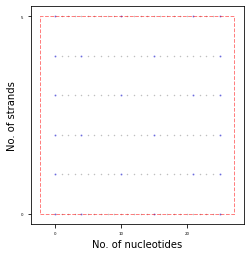

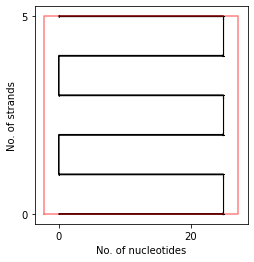

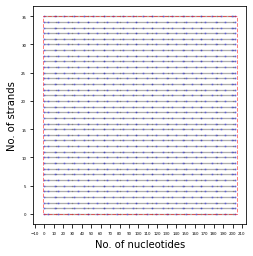

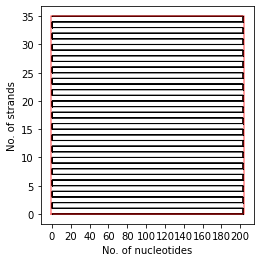

In [3]:
square = np.array([[0.0, 0.0, 0.0], [10.0, 0.0, 0.0], [10.0, 10.0, 0.0], [0.0, 10.0, 0.0]])

# Generate the oxDNA file but don't show or output the plots
generate(square, DNAout="square", PLOTout=None, plot=True)
generate(square*7, DNAout="square", PLOTout=None, plot=True)

## Generating trapeziums

*Note:* as we can see with the plot (as shown below) the first trapezium (size 10) is too small and the sides too shallow for the desired shape to form.

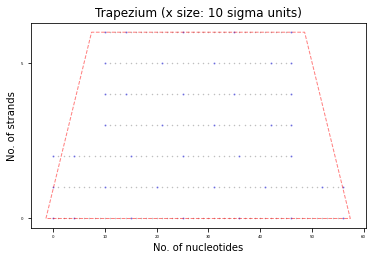

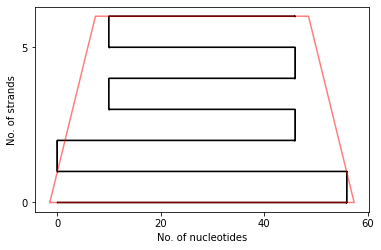

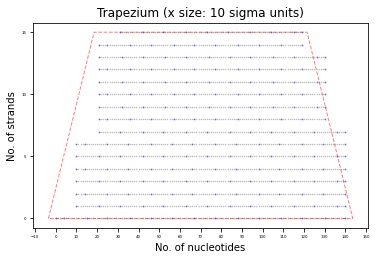

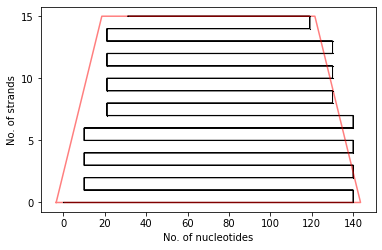

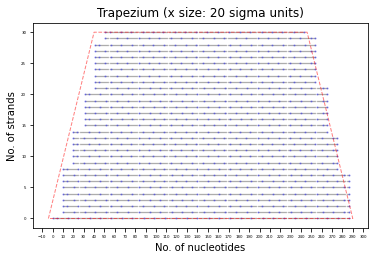

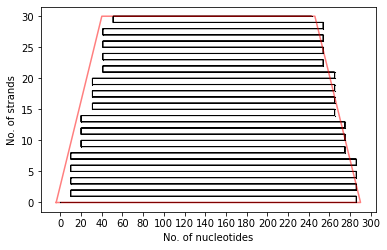

In [4]:
trap = np.array([[0.,0.,0.],[1.5,6.,0.],[8.5,6.,0.],[10.,0.,0.]])
generate(trap*2, DNAout="trap20", PLOTout=None, plot = True, title = "Trapezium (x size: 10 sigma units)")
generate(trap*5, DNAout="trap50", PLOTout=None, plot = True, title = "Trapezium (x size: 10 sigma units)")
generate(trap*10, DNAout="trap100", PLOTout=None, plot = True, title = "Trapezium (x size: 20 sigma units)")

| ![title](oxDNA_renders/trap_40.png) | 
| --- |

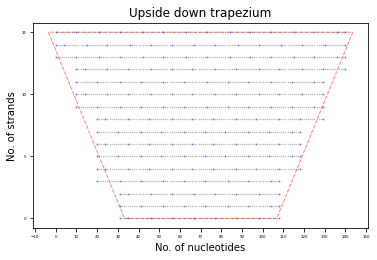

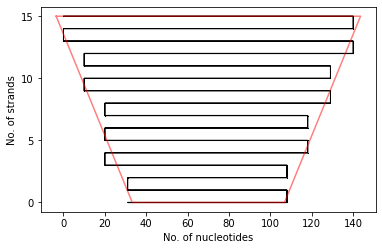

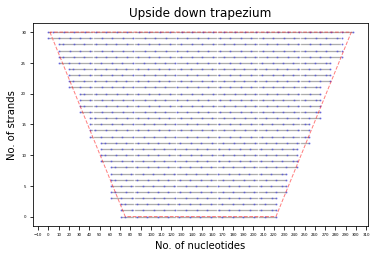

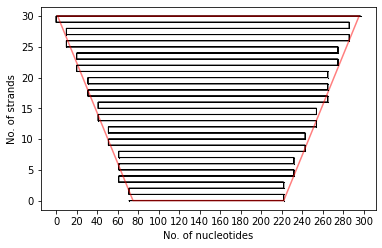

In [5]:
trapREV = np.array([[0.,10.,0.],[2.5,4.,0.],[7.5,4.,0.],[10.,10.,0.]])
generate(trapREV*5, DNAout="trapezium_rev5",PLOTout=None, plot=True, title="Upside down trapezium")
generate(trapREV*10, DNAout="trapezium_rev10",PLOTout=None, plot=True, title="Upside down trapezium")

## Generating triangles

As can be seen, once again, where the inputted shape is too small, the generated scaffold and lattice can struggle with corresponding to that shape.

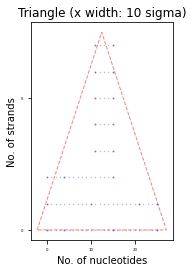

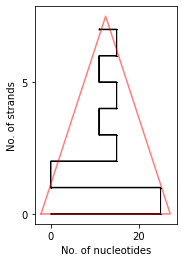

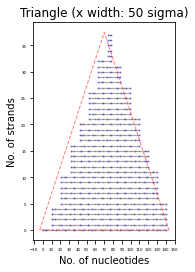

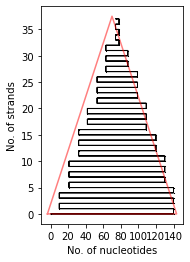

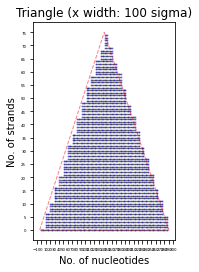

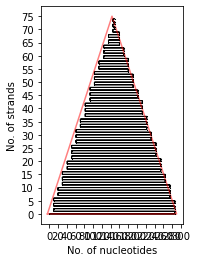

In [6]:
triangle = np.array([[0,0,0],[5,15,0],[10,0,0]])
generate(triangle, DNAout="triangle5",PLOTout=None, plot= True, title = "Triangle (x width: 10 sigma)")
generate(triangle*5, DNAout="triangle_20",PLOTout=None, plot= True, title = "Triangle (x width: 50 sigma)")
generate(triangle*10, DNAout="triangle_50",PLOTout=None, plot= True, title = "Triangle (x width: 100 sigma)")

## Generating hexagons
The medium sized flat base suffers the most using the current algorithm. But overall, the final scaffold is fairly similar to the inputted polygons.

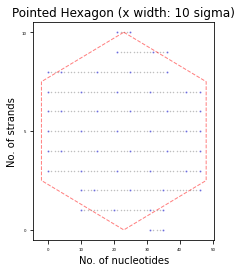

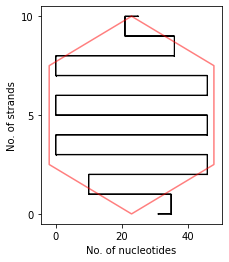

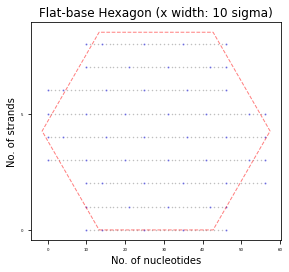

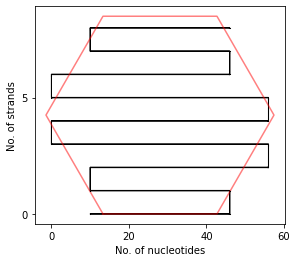

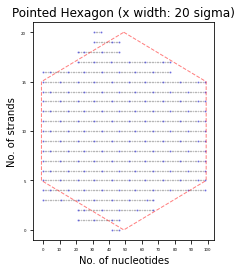

...

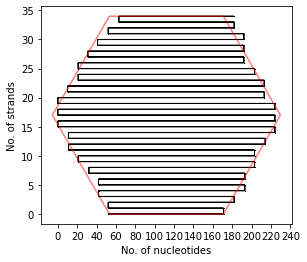

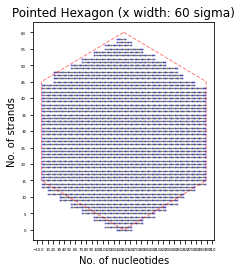

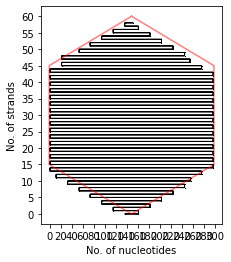

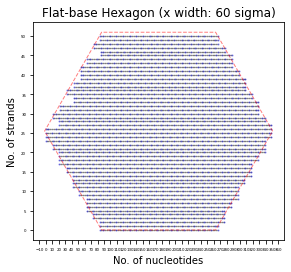

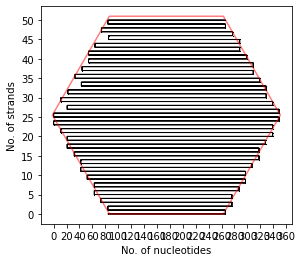

In [7]:
pointy_hex = np.array([[0, 1, 0], [0.85, 0.5, 0], [0.85, -0.5, 0], [0, -1, 0], [-0.85, -0.5, 0], [-0.85, 0.5, 0]])
flat_hex = np.array([[1.0,-0.85,0],[2.0, -0.85, 0],[2.5, 0, 0],[2.0, 0.85,0],[1.0,0.85,0],[0.5, 0.0,0.0]])
generate(pointy_hex*10, DNAout="pointy_hex10",PLOTout=None, plot= True, title = "Pointed Hexagon (x width: 10 sigma)")
generate(flat_hex*10, DNAout="flat_hex10",PLOTout=None, plot= True, title = "Flat-base Hexagon (x width: 10 sigma)")
generate(pointy_hex*20, DNAout="pointy_hex20",PLOTout=None, plot= True, title = "Pointed Hexagon (x width: 20 sigma)")
generate(flat_hex*20, DNAout="flat_hex20",PLOTout=None, plot= True, title = "Flat-base Hexagon (x width: 20 sigma)")
generate(pointy_hex*40, DNAout="pointy_hex40",PLOTout=None, plot= True, title = "Pointed Hexagon (x width: 40 sigma)")
generate(flat_hex*40, DNAout="flat_hex40",PLOTout=None, plot= True, title = "Flat-base Hexagon (x width: 40 sigma)")
generate(pointy_hex*60, DNAout="pointy_hex60",PLOTout=None, plot= True, title = "Pointed Hexagon (x width: 60 sigma)")
generate(flat_hex*60, DNAout="flat_hex60",PLOTout=None, plot= True, title = "Flat-base Hexagon (x width: 60 sigma)")

## Generating modular shapes (e.g. a plus, capital letter I, stacked I's)

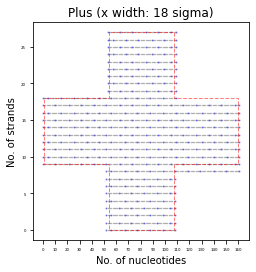

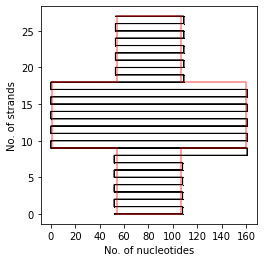

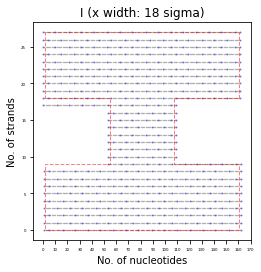

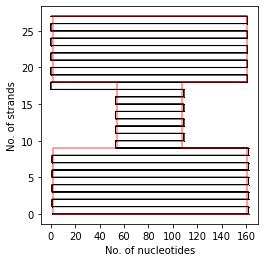

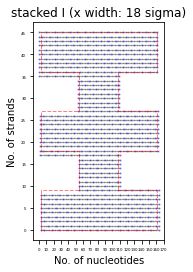

...

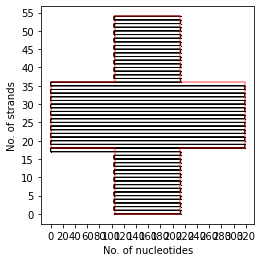

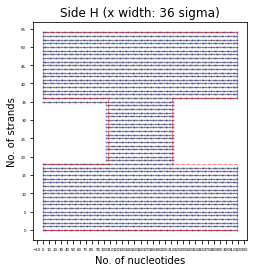

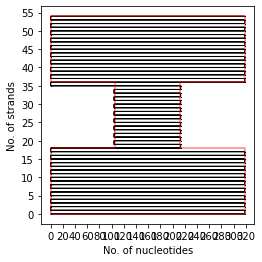

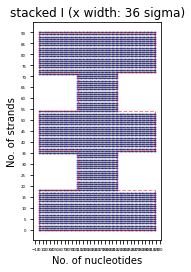

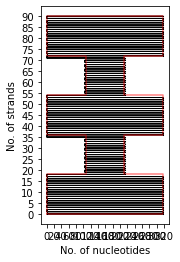

In [8]:
plus = np.array([
    [1.,0.,0.], [2.,0.,0.], [2.,1.,0.], [3.,1.,0.], [3.,2.,0.], [2.,2.,0.],
    [2.,3.,0.], [1.,3.,0.], [1.,2.,0.], [0.,2.,0.], [0.,1.,0.], [1.,1.,0.]
    ])
capital_I = np.array([
    [0.,0.,0.],[3.,0.,0.],[3.,1.,0.],[2.,1.,0.], [2.,2.,0.],[3.,2.,0.],
    [3.,3.,0.],[0.,3.,0.],[0.,2.,0.],[1.,2.,0.],[1.,1.,0.],[0.,1.,0.]
    ])
stacked_I = np.array([
    [0.,0.,0.],[3.,0.,0.],[3.,1.,0.],[2.,1.,0.], [2.,2.,0.],[3.,2.,0.],
    [3.,3.,0.],[2.,3.,0.],[2.,4.,0.],[3.,4.,0.],[3.,5.,0.],[0.,5.,0.],[0.,4.,0.],[1.,4.,0.],
    [1.,3.,0.],[0.,3.,0.], [0.,2.,0.],[1.,2.,0.],[1.,1.,0.],[0.,1.,0.]
    ])
    
generate(plus*18, DNAout="plus_18",PLOTout=None, plot= True, title = "Plus (x width: 18 sigma)")
generate(capital_I*18, DNAout="I_18",PLOTout=None, plot= True, title = "I (x width: 18 sigma)")
generate(stacked_I*18, DNAout="II_18",PLOTout=None, plot= True, title = "stacked I (x width: 18 sigma)")
generate(plus*36, DNAout="plus_36",PLOTout=None, plot= True, title = "Plus (x width: 36 sigma)")
generate(capital_I*36, DNAout="I_36",PLOTout=None, plot= True, title = "Side H (x width: 36 sigma)")
generate(stacked_I*36, DNAout="II_36",PLOTout=None, plot= True, title = "stacked I (x width: 36 sigma)")

## Generating an Octagon


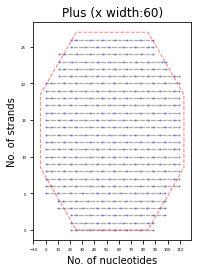

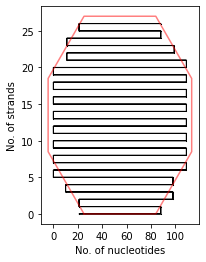

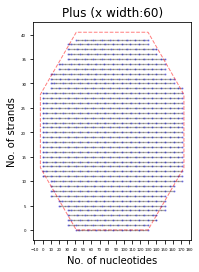

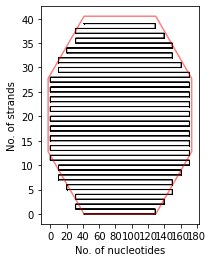

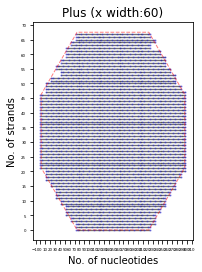

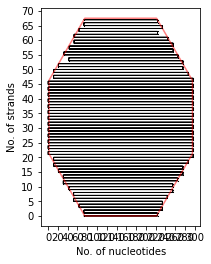

In [9]:
octagon = np.array([[1.0,-0.85,0],[2.0, -0.85, 0],[2.5, 0, 0],[2.5, 1,0],
    [2.0, 1.85,0],[1.0,1.85,0],[0.5,1,0],[0.5, 0.0,0.0]])
generate(octagon*20, DNAout="octagon20",PLOTout=None, plot= True, title = "Plus (x width:60)")    
generate(octagon*30, DNAout="octagon30",PLOTout=None, plot= True, title = "Plus (x width:60)")
generate(octagon*50, DNAout="octagon50",PLOTout=None, plot= True, title = "Plus (x width:60)")


## Generating a diamond

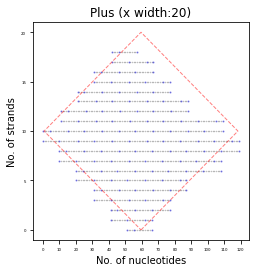

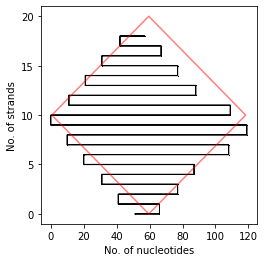

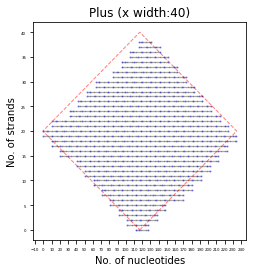

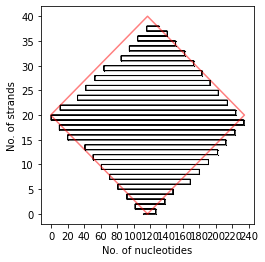

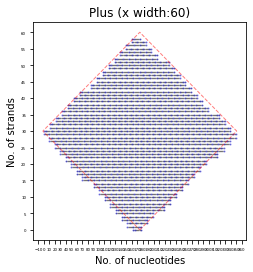

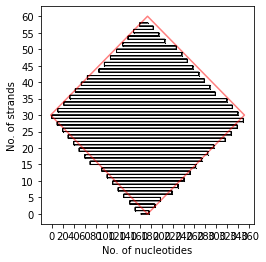

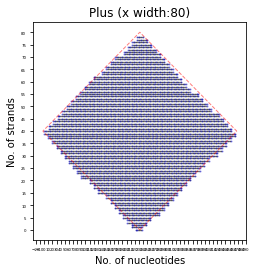

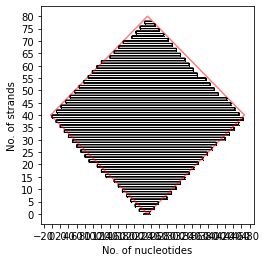

In [10]:
diamond = np.array([[1.,0.,0.],[2.,1.,0.],[1.,2.,0.],[0.,1.,0.]])

generate(diamond*20, DNAout="diamond20",PLOTout=None, plot= True, title = "Plus (x width:20)")    
generate(diamond*40, DNAout="diamond40",PLOTout=None, plot= True, title = "Plus (x width:40)")    
generate(diamond*60, DNAout="diamond60",PLOTout=None, plot= True, title = "Plus (x width:60)")
generate(diamond*80, DNAout="diamond80",PLOTout=None, plot= True, title = "Plus (x width:80)")

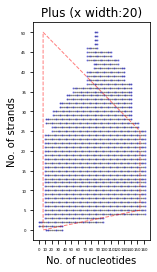

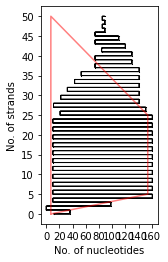

In [11]:
non_sym = np.array([[0.,0.,0.],[5.,1.,0.],[5.,5.,0.],[0.,10.,0.]])

generate(non_sym*10, DNAout="non_sym20",PLOTout="non_sym20", plot= True, title = "Plus (x width:20)") 